In [2]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sklearn import metrics
import plotly.graph_objects as go

In [10]:
y_truth = np.array([1 if i >= 300 and i <=399 else 0 for i in range(600)])
print(y_truth)

# eval all
def calc_accuracy(row):
    # ignore unseen graphs
    seen_graphs = row!=-2
    y_pred = (row == -1).astype(int)
    acc = metrics.accuracy_score(y_truth[seen_graphs], y_pred[seen_graphs])
    return acc
# eval all
def calc_roc_precision_recall(row):
    y_pred = np.array(row.values)
    assert y_pred.shape == y_truth.shape
    
    # ignore unseen graphs
    seen_graphs = row!=-2
    
    fpr, tpr, thresholds = metrics.roc_curve(y_truth[seen_graphs], y_pred[seen_graphs])
    auc = metrics.auc(fpr, tpr)

    precision, recall, pr_thresholds = metrics.precision_recall_curve(y_truth[seen_graphs], y_pred[seen_graphs])
    ap = metrics.auc(recall, precision)
    
    return pd.Series([auc, ap])


# eval current iteration update
def calc_accuracy_current_updated(row):
    # ignore unseen graphs
    y_pred_df = row.dropna()
#     seen_graphs = row!=-2
    y_pred = (y_pred_df == -1).astype(int)
    acc = metrics.accuracy_score(y_truth[y_pred_df.index], y_pred)
    return acc

# eval current iteration update
def calc_auc_precision_recall_updated(row):
    y_pred_df = row.dropna()
    y_pred = np.array(y_pred_df.values)
    
    y_true_ = y_truth[y_pred_df.index]
    assert y_true_.shape == y_pred.shape
    
    if len(y_true_) < 1:
        return None
    try:
        fpr, tpr, thresholds = metrics.roc_curve(y_true_, y_pred, pos_label=1)
        auc = metrics.auc(fpr, tpr)
    except:
        auc = None
    
    try:
        precision, recall, pr_thresholds = metrics.precision_recall_curve(y_true_, y_pred, pos_label=1)
        ap = metrics.auc(recall, precision)
    except:
        ap = None

    return pd.Series([auc, ap])

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 

## Without controlling # of attack graphs seen in each interation

In [21]:
stream_anomaly_iterations_path = '../baseline/sbustreamspot-data/random_noise_attack_gfc_results/anomaly_score_iterations_gfc_noise{}_attack{}.txt'
stream_cluster_iterations_path = '../baseline/sbustreamspot-data/random_noise_attack_gfc_results/cluster_map_iterations_gfc_noise{}_attack{}.txt'
stream_update_graph_path = '../baseline/sbustreamspot-data/random_noise_attack_gfc_results/updated_graph_iterations_gfc_noise{}_attack{}.txt'


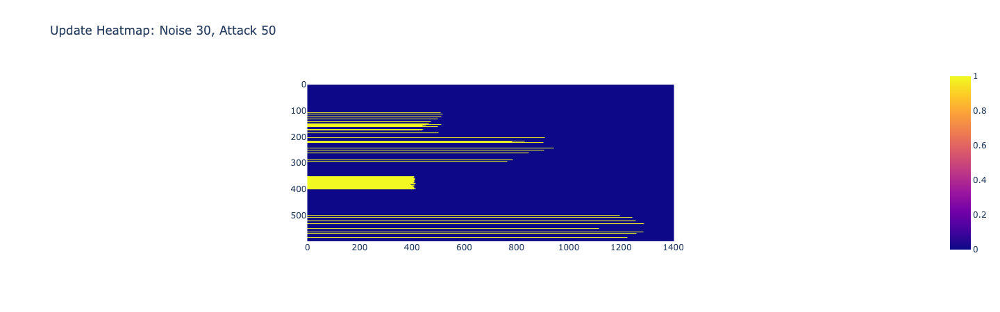

In [22]:
i = 30
j = 50
fig = px.imshow(
    pd.read_csv(stream_update_graph_path.format(i,j), sep=' ', header=None).dropna(axis=1).T, 
    title=f'Update Heatmap: Noise {i}, Attack {j}')
fig

In [19]:
current_eval_df_list = []
for i in range(0, 51, 10): # i = number of noise graphs
    for j in range(0, 51, 10): # i = number of attack graphs
        print(f'Progress: {i}')
        anomaly_iter_df = pd.read_csv(stream_anomaly_iterations_path.format(i, j), sep=' ', header=None).dropna(axis=1)
        cluster_iter_df = pd.read_csv(stream_cluster_iterations_path.format(i, j), sep=' ', header=None).dropna(axis=1)
        update_graph_iter_df = pd.read_csv(stream_update_graph_path.format(i, j), sep=' ', header=None).dropna(axis=1)

        updated_anomaly_df = anomaly_iter_df[update_graph_iter_df.astype('bool')]
        updated_cluster_df = cluster_iter_df[update_graph_iter_df.astype('bool')]

        streaming_eval = updated_anomaly_df.apply(lambda x: calc_auc_precision_recall_updated(x), axis=1)

        streaming_eval.columns = ['AUC', 'AP']
        streaming_eval['Noise#,Attack#'] = f'{i},{j}'

        streaming_eval['Accuracy'] = updated_cluster_df.apply(lambda x: calc_accuracy_current_updated(x), axis=1)

        current_eval_df_list.append(streaming_eval)

current_streaming_evals = pd.concat(current_eval_df_list).reset_index().rename(columns={'index':'edge_seen'})
current_streaming_evals


Progress: 0


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 0


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 0


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 0


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 0


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 0


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 10


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 10


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 10


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 10


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 10


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 10


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 20


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 20


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 20


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 20


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 20


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 20


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 30


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 30


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 30


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 30


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 30


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 30


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 40


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 40


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 40


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 40


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 40


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 40


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 50


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 50


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 50


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 50


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 50


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

Progress: 50


/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:813: UndefinedMetricWarning:

No positive samples in y_true, true positive value should be meaningless

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:681: RuntimeWarning:

invalid value encountered in true_divide

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/lib/function_base.py:380: RuntimeWarning:

Mean of empty slice.

/Users/jl102430/anaconda3/envs/python37/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning:

invalid value encountered in double_scalars

/Users/jl102430/anaconda3/envs/python37/lib/py

,edge_seen,AUC,AP,"Noise#,Attack#",Accuracy
0,0,NaN,NaN,"0,0",1.000000
1,1,NaN,NaN,"0,0",1.000000
2,2,NaN,NaN,"0,0",0.936170
3,3,NaN,NaN,"0,0",1.000000
4,4,NaN,NaN,"0,0",0.946809
...,...,...,...,...,...
50857,1350,NaN,NaN,"50,50",NaN
50858,1351,NaN,NaN,"50,50",NaN
50859,1352,NaN,NaN,"50,50",NaN
50860,1353,NaN,NaN,"50,50",NaN


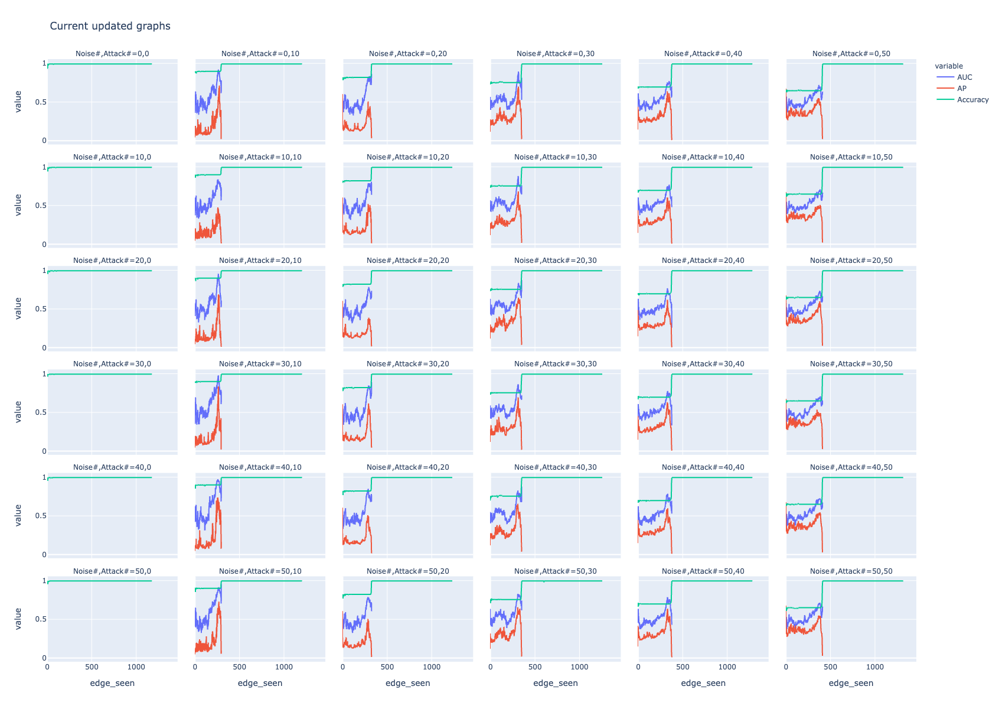

In [20]:
px.line(current_streaming_evals,
        x='edge_seen', y=['AUC', 'AP', 'Accuracy'],
        facet_col='Noise#,Attack#',
        title='Current updated graphs',
        facet_row_spacing=0.03, 
#         facet_col_spacing=0.01,
        height=1200,
        facet_col_wrap=6)

### Fixed Attack Edges in Iteration

In [23]:
fix_stream_anomaly_iterations_path = '../baseline/sbustreamspot-data/noise_attack_gfc_results/anomaly_score_iterations_gfc_noise{}_attack{}.txt'
fix_stream_cluster_iterations_path = '../baseline/sbustreamspot-data/noise_attack_gfc_results/cluster_map_iterations_gfc_noise{}_attack{}.txt'
fix_stream_update_graph_path = '../baseline/sbustreamspot-data/noise_attack_gfc_results/updated_graph_iterations_gfc_noise{}_attack{}.txt'


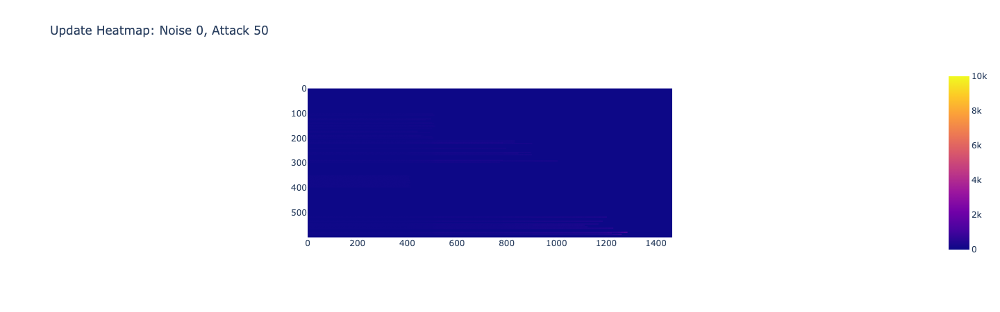

In [25]:
i = 30
j = 50
fig = px.imshow(
    pd.read_csv(fix_stream_update_graph_path.format(i,j), sep=' ', header=None).dropna(axis=1).T, 
    title=f'Update Heatmap: Noise {i}, Attack {j}')
fig

In [31]:
update_counts = pd.read_csv(fix_stream_update_graph_path.format(i,j), sep=' ', header=None).dropna(axis=1)
update_counts[[i for i in range(300,400)]].sum(axis=1).sum()

1421763

In [32]:
1421763/1323

1074.6507936507937